In [17]:
pip install plotly

In [18]:
from plotly.offline import plot, iplot, init_notebook_mode
init_notebook_mode(connected=True)

In [19]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math
import numpy as np
import math
from scipy import stats
import os
import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go
energy = pd.read_csv("energy_cleaned.csv")

In [20]:
energy

,country,year,electricity_access_%,clean_fuels_access_%,renewable_energy_share_final,electricity_fossil_fuels_output,electricity_nuclear_output,electricity_renewables_output,electricity_low_carbon,energy_consumption_per_capita,...,renewable_energy_share_primary,gdp_growth,gdp_per_capita,density,land_area,lat,lon,land_area_category,density_category,quadrant
0,Algeria,2000,98.97310,97.10,0.43,23.84,0.0,0.05,0.209293,9746.524,...,0.053235,3.800000,1765.027146,18,2381741.0,28.033886,1.659626,large,sparse,NE
1,Algeria,2001,98.96687,97.30,0.43,24.96,0.0,0.07,0.279664,9961.640,...,0.065218,3.000000,1740.606654,18,2381741.0,28.033886,1.659626,large,sparse,NE
2,Algeria,2002,98.95306,97.80,0.51,25.94,0.0,0.06,0.230769,10180.350,...,0.051677,5.600000,1781.828908,18,2381741.0,28.033886,1.659626,large,sparse,NE
3,Algeria,2003,98.93401,98.00,0.47,27.54,0.0,0.26,0.935252,10510.461,...,0.228104,7.200000,2103.381291,18,2381741.0,28.033886,1.659626,large,sparse,NE
4,Algeria,2004,98.91208,98.20,0.44,29.14,0.0,0.25,0.850630,10759.022,...,0.206787,4.300000,2610.185422,18,2381741.0,28.033886,1.659626,large,sparse,NE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1486,Uzbekistan,2016,100.00000,85.20,1.61,48.75,0.0,7.25,12.946428,16374.342,...,3.567936,5.932151,2704.677188,79,447400.0,41.377491,64.585262,medium,populated,NE
1487,Uzbekistan,2017,100.00000,84.90,1.75,49.71,0.0,8.35,14.381675,16642.676,...,3.972285,4.395275,1916.764642,79,447400.0,41.377491,64.585262,medium,populated,NE
1488,Uzbekistan,2018,100.00000,84.30,1.49,53.58,0.0,5.85,9.843514,16445.740,...,2.927033,5.354997,1597.068337,79,447400.0,41.377491,64.585262,medium,populated,NE
1489,Uzbekistan,2019,100.00000,84.60,1.57,53.64,0.0,6.47,10.763600,16212.221,...,3.197033,5.709632,1784.009816,79,447400.0,41.377491,64.585262,medium,populated,NE


In [21]:
density_order = ['sparse', 'populated', 'packed']
land_area_order = ['small', 'medium', 'large']
gdp_matrix = energy.groupby(['density_category', 'land_area_category'])['gdp_per_capita'].mean().unstack()
gdp_matrix = gdp_matrix.reindex(index=density_order, columns=land_area_order)
fig = go.Figure(data=[go.Surface(z=gdp_matrix.values,
                                 x=land_area_order,
                                 y=density_order,
                                 colorscale='Viridis',
                                 showscale=False)])
quadrant_colors = {'NW': 'red', 'NE': 'blue', 'SW': 'green', 'SE': 'purple'}
fig.add_trace(go.Scatter3d(
    x=energy['land_area_category'],
    y=energy['density_category'],
    z=energy['gdp_per_capita'],
    mode='markers',
    marker=dict(
        size=5,
        color=[quadrant_colors[q] for q in energy['quadrant']],
        opacity=0.6
    ),
    text=energy.apply(lambda row: f"Country: {row['country']}<br>Year: {row['year']}<br>GDP per Capita: ${row['gdp_per_capita']:,.0f}<br>Land Area: {row['land_area_category']}<br>Density: {row['density_category']}<br>Quadrant: {row['quadrant']}", axis=1),
    hoverinfo='text',
    showlegend=False
))
fig.update_layout(
    title='GDP per Capita by Density and Land Area Categories',
    scene=dict(
        xaxis_title='Land Area Category',
        yaxis_title='Density Category',
        zaxis_title='GDP per Capita',
        xaxis=dict(
            ticktext=land_area_order,
            tickvals=list(range(len(land_area_order)))
        ),
        yaxis=dict(
            ticktext=density_order,
            tickvals=list(range(len(density_order)))
        )
    ),
    width=900,
    height=700,
    margin=dict(r=20, l=10, b=10, t=40)
)
fig.update_traces(
    selector=dict(type='surface'),
    hovertemplate='<b>Land Area</b>: %{x}' +
                  '<br><b>Density</b>: %{y}' +
                  '<br><b>GDP per Capita</b>: $%{z:,.0f}<extra></extra>'
)
for quadrant, color in quadrant_colors.items():
    fig.add_trace(go.Scatter3d(
        x=[None], y=[None], z=[None],
        mode='markers',
        marker=dict(size=10, color=color),
        showlegend=True,
        name=f'Quadrant {quadrant}'
    ))
fig.show()

The more elevated surfaces represent higher gdp_per_capita. Sunken surfaces represent lows.

Highest gdp_per_capita occurs at packed, small countries. <br>
Lowest gdp_per_capita occurs at packed, large countries. <br>
Small, packed, countries in the NE quadrant like Luxembourg, Switzerland, and Qatar dominate higher gdp_per_capita values. Being more compact allows for more efficient energy delivery and infrastructure. <br>
Large, packed countries like China, Pakistan, India, Thailand are overburdened by energy demands and lack the infrastructure to meet them. <br>


In [22]:
exclude_columns = ['lat', 'lon', 'gdp_per_capita', 'land_area_category', 'density_category', 'quadrant', 'country', 'year']
columns_to_plot = [col for col in energy.columns if col not in exclude_columns]
num_plots = len(columns_to_plot)
num_rows = math.ceil(num_plots / 3)
fig = sp.make_subplots(
    rows=num_rows,
    cols=3,
    subplot_titles=columns_to_plot,
    horizontal_spacing=0.05,
    vertical_spacing=0.05,
)

custom_colors = ['green', 'blue', 'red']
hue_order = ['small', 'medium', 'large']

for i, column in enumerate(columns_to_plot):
    row = i // 3 + 1
    col = i % 3 + 1

    scatter = px.scatter(
        energy,
        x=column,
        y='gdp_per_capita',
        color='land_area_category',
        category_orders={'land_area_category': hue_order},
        color_discrete_sequence=custom_colors,
        title=f'GDP per Capita vs {column.replace("_", " ").title()}',
        labels={column: column.replace('_', ' ').title(), 'gdp_per_capita': 'GDP per Capita ($)'},
        custom_data=['country', 'year', 'density_category', 'land_area_category', 'quadrant']
    )

    scatter.update_traces(
        hovertemplate="<b>%{customdata[0]}</b><br>" +
                      "Year: %{customdata[1]}<br>" +
                      "GDP per Capita: $%{y:,.0f}<br>" +
                      f"{column.replace('_', ' ').title()}: %{{x}}<br>" +
                      "Density Category: %{customdata[2]}<br>" +
                      "Land Area Category: %{customdata[3]}<br>" +
                      "Quadrant: %{customdata[4]}<extra></extra>"
    )

    for j, trace in enumerate(scatter['data']):
        if row == 1 and col == 1:
            fig.add_trace(trace, row=row, col=col)
        else:
            trace.showlegend = False
            fig.add_trace(trace, row=row, col=col)

fig.update_layout(
    height=400*num_rows,
    width=1200,
    title_text="GDP per Capita vs Features Visualized Through Land Area",
    showlegend=True,
    legend_title_text='Land Area Category',
    margin=dict(l=50, r=50, t=50, b=50),
    font=dict(size=10),
)

for i in fig['layout']['annotations']:
    i['font'] = dict(size=10)

fig.show()

In [23]:
exclude_columns = ['lat', 'lon', 'gdp_per_capita', 'land_area_category', 'density_category', 'quadrant', 'country', 'year']
columns_to_plot = [col for col in energy.columns if col not in exclude_columns]
num_plots = len(columns_to_plot)
num_rows = math.ceil(num_plots / 3)

fig = sp.make_subplots(
    rows=num_rows,
    cols=3,
    subplot_titles=columns_to_plot,
    horizontal_spacing=0.05,
    vertical_spacing=0.05,
)

custom_colors = ['green', 'blue', 'red']
hue_order = ['sparse', 'populated', 'packed']

for i, column in enumerate(columns_to_plot):
    row = i // 3 + 1
    col = i % 3 + 1

    scatter = px.scatter(
        energy,
        x=column,
        y='gdp_per_capita',
        color='density_category',
        category_orders={'density_category': hue_order},
        color_discrete_sequence=custom_colors,
        title=f'GDP per Capita vs {column.replace("_", " ").title()}',
        labels={column: column.replace('_', ' ').title(), 'gdp_per_capita': 'GDP per Capita ($)'},
        custom_data=['country', 'year', 'density_category', 'land_area_category', 'quadrant']
    )

    scatter.update_traces(
        hovertemplate="<b>%{customdata[0]}</b><br>" +
                      "Year: %{customdata[1]}<br>" +
                      "GDP per Capita: $%{y:,.0f}<br>" +
                      f"{column.replace('_', ' ').title()}: %{{x}}<br>" +
                      "Density Category: %{customdata[2]}<br>" +
                      "Land Area Category: %{customdata[3]}<br>" +
                      "Quadrant: %{customdata[4]}<extra></extra>"
    )

    for j, trace in enumerate(scatter['data']):
        if row == 1 and col == 1:
            fig.add_trace(trace, row=row, col=col)
        else:
            trace.showlegend = False
            fig.add_trace(trace, row=row, col=col)

fig.update_layout(
    height=400*num_rows,
    width=1200,
    title_text="GDP per Capita vs Features Visualized Through Density",
    showlegend=True,
    legend_title_text='Density Category',
    margin=dict(l=50, r=50, t=50, b=50),
    font=dict(size=10),
)

for i in fig['layout']['annotations']:
    i['font'] = dict(size=10)

fig.show()

In [24]:
exclude_columns = ['lat', 'lon', 'gdp_per_capita', 'land_area_category', 'density_category', 'quadrant', 'country', 'year']
columns_to_plot = [col for col in energy.columns if col not in exclude_columns]
num_plots = len(columns_to_plot)
num_rows = math.ceil(num_plots / 3)
fig = sp.make_subplots(
    rows=num_rows,
    cols=3,
    subplot_titles=columns_to_plot,
    horizontal_spacing=0.05,
    vertical_spacing=0.05,
)
custom_colors = ['green', 'blue', 'red', 'orange']

for i, column in enumerate(columns_to_plot):
    row = i // 3 + 1
    col = i % 3 + 1
    scatter = px.scatter(
        energy,
        x=column,
        y='gdp_per_capita',
        color='quadrant',
        category_orders={'quadrant': hue_order},
        color_discrete_sequence=custom_colors,
        title=f'GDP per Capita vs {column.replace("_", " ").title()}',
        labels={column: column.replace('_', ' ').title(), 'gdp_per_capita': 'GDP per Capita ($)'},
        custom_data=['country', 'year', 'density_category', 'land_area_category', 'quadrant']
    )
    scatter.update_traces(
        hovertemplate="<b>%{customdata[0]}</b><br>" +
                      "Year: %{customdata[1]}<br>" +
                      "GDP per Capita: $%{y:,.0f}<br>" +
                      f"{column.replace('_', ' ').title()}: %{{x}}<br>" +
                      "Density Category: %{customdata[2]}<br>" +
                      "Land Area Category: %{customdata[3]}<br>" +
                      "Quadrant: %{customdata[4]}<extra></extra>"
    )
    for j, trace in enumerate(scatter['data']):
        if row == 1 and col == 1:
            fig.add_trace(trace, row=row, col=col)
        else:
            trace.showlegend = False
            fig.add_trace(trace, row=row, col=col)
fig.update_layout(
    height=400*num_rows,
    width=1200,
    title_text="GDP per Capita vs Features Visualized Through Quadrant",
    showlegend=True,
    legend_title_text='Density Category',
    margin=dict(l=50, r=50, t=50, b=50),
    font=dict(size=10),
)
for i in fig['layout']['annotations']:
    i['font'] = dict(size=10)
fig.show()

In [25]:
exclude_corr_columns = ['land_area_category', 'density_category', 'quadrant', 'country', 'year']
spearman_corr = energy.drop(columns=exclude_corr_columns).corr(method='spearman')
gdp_corr = spearman_corr['gdp_per_capita']
sorted_gdp_corr = gdp_corr.sort_values(ascending=False)

In [26]:
sorted_gdp_corr

,gdp_per_capita
gdp_per_capita,1.000000
clean_fuels_access_%,0.818422
energy_consumption_per_capita,0.816881
electricity_access_%,0.712920
lat,0.400999
electricity_low_carbon,0.216348
electricity_nuclear_output,0.189147
renewable_energy_share_primary,0.147627
electricity_renewables_output,0.136840
density,0.017788


Strongest correlators with gdp_per_capita: <br>

* clean_fuels_access%(0.81)
* energy_consumption_per_capita (0.81)
* electricity_access_% (0.71)

Weakest correlators with gdp_per_capita: <br>
* land_area (-0.35)
* gdp_growth (-0.36)


In [27]:
exclude_corr_columns = ['land_area_category', 'density_category', 'quadrant', 'country', 'year']
spearman_corr = energy.drop(columns=exclude_corr_columns).corr(method='spearman')
fig = px.imshow(
    spearman_corr,
    text_auto=True,
    color_continuous_scale='RdBu_r',
    title='Spearman Correlation Heatmap',
    labels=dict(color='Correlation')
)

fig.update_layout(
    title_x=0.5,
    width=800,
    height=800,
    xaxis_title='Features',
    yaxis_title='Features'
)
fig.show()

energy_consumption_per_capita is strongly correlated with clean_fuels_access_% (0.79) and electricity_access_% (0.71). <br>

Other strong correlations: <br>

* renewable_energy_share_primary and renewable_energy_share_final (0.79)<br>
* renewable_energy_share_primary and electricity_low_carbon (0.85) <br>
* electricity_fossil_fuels_output and co2_emissions_per_capita (0.95) <br>
* land_area and co2_emissions_per_capita (0.69) <br>








In [28]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
exclude_corr_columns = ['land_area_category', 'density_category', 'quadrant', 'country', 'year']
numeric_df = energy.drop(columns=exclude_corr_columns)
scaler = StandardScaler()
scaled_df = scaler.fit_transform(numeric_df)
pca = PCA()
features_PCA = pca.fit(scaled_df)

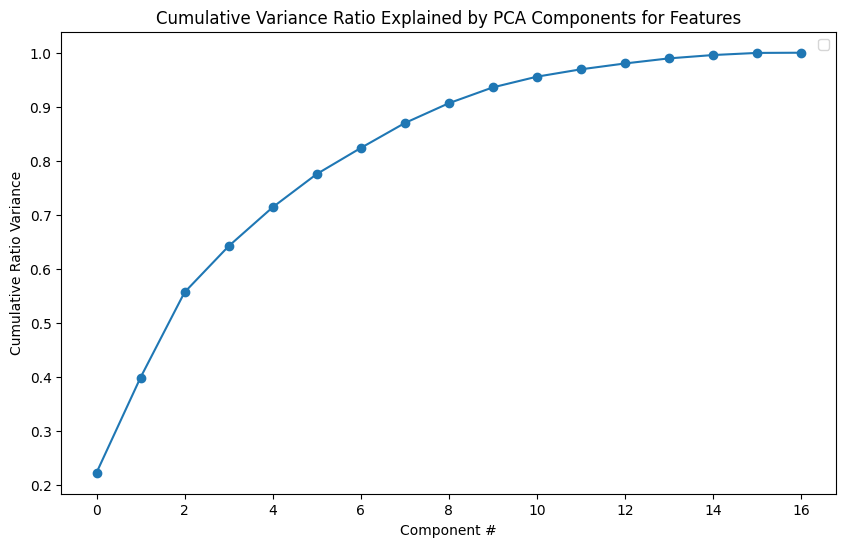

In [29]:
plt.subplots(figsize=(10, 6))
plt.plot(features_PCA.explained_variance_ratio_.cumsum(), marker='o')
plt.xlabel('Component #')
plt.ylabel('Cumulative Ratio Variance')
plt.title('Cumulative Variance Ratio Explained by PCA Components for Features')
plt.legend()
plt.show()

I choose component # 2 as the elbow point.

In [30]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

exclude_corr_columns = ['land_area_category', 'density_category', 'quadrant', 'country', 'year']
numeric_df = energy.drop(columns=exclude_corr_columns)

scaler = StandardScaler()
scaled_df = scaler.fit_transform(numeric_df)

pca = PCA(n_components=3)
principal_components = pca.fit_transform(scaled_df)

x = principal_components[:, 0]
y = principal_components[:, 1]
z = principal_components[:, 2]

data = pd.DataFrame({
    'PC1': x,
    'PC2': y,
    'PC3': z,
    'Country': energy['country'],
    'Year': energy['year']
})

fig = make_subplots(rows=2, cols=2, subplot_titles=('PC1 vs PC2', 'PC1 vs PC3', 'PC2 vs PC3'))

plot_combinations = [
    ('PC1', 'PC2', 1, 1),
    ('PC1', 'PC3', 1, 2),
    ('PC2', 'PC3', 2, 1)
]
for pc1, pc2, row, col in plot_combinations:
    fig.add_trace(
        go.Scatter(
            x=data[pc1],
            y=data[pc2],
            mode='markers',
            text=data.apply(lambda row: f"Country: {row['Country']}<br>Year: {row['Year']}", axis=1),
            hoverinfo='text+x+y',
            name=f'{pc1} vs {pc2}'
        ),
        row=row, col=col
    )
    fig.update_xaxes(title_text=pc1, row=row, col=col)
    fig.update_yaxes(title_text=pc2, row=row, col=col)
fig.update_layout(
    height=800,
    width=1000,
    title_text=f'Features summary PCA, {pca.explained_variance_ratio_.sum()*100:.1f}% variance explained',
    showlegend=False
)
fig.show()

PC1 distinctly shows unique groupings for US and China when compared to PC2 and PC3. PC2 vs PC3 is less evident.

In [31]:
scaled_df = pd.DataFrame(scaled_df, columns=numeric_df.columns)

In [32]:
pca_components_df = pd.DataFrame(features_PCA.components_, columns=scaled_df.columns)

def sort_features_by_loading(component):
    return component.abs().sort_values(ascending=False)
for i in range(1):
    print(f"\nTop 10 features for PC1:")
    sorted_features = sort_features_by_loading(pca_components_df.iloc[i])
    print(sorted_features.head(10))


Top 10 features for PC1:
co2_emissions_per_capita           0.483194
electricity_fossil_fuels_output    0.482664
electricity_renewables_output      0.466680
land_area                          0.404643
electricity_nuclear_output         0.366145
lon                                0.073559
electricity_low_carbon             0.055312
gdp_per_capita                     0.051694
density                            0.043888
electricity_access_%               0.040072
Name: 0, dtype: float64


5 Distinct Top Loaders: <br>
1. co2_emissions_per_capita (0.48)
2. electricity_fossil_fuels_output (0.48)
3. electricity_renewables_output (0.46)
4. land_area (0.40)
5. electricity_nuclear_output (0.36)  